<p align = "center" draggable=”false” ><img src="https://user-images.githubusercontent.com/37101144/161836199-fdb0219d-0361-4988-bf26-48b0fad160a3.png" 
     width="200px"
     height="auto"/>
</p>

# Hate Speech Detector

Today you are a machine learning engineer, a member of the Birdwatch at Twitter. 

The objective of this task is to detect hate speech in tweets. For the sake of simplicity, a tweet contains hate speech if it has a racist or sexist sentiment associated with it. In other words, we need to classify racist or sexist tweets from other tweets.

A labelled dataset of 31,962 tweets (late 2017 to early 2018) is provided in the form of a compressed csv file with each line storing a tweet id, its label, and the tweet. Label '1' denotes the tweet is racist/sexist while label '0' denotes the tweet is not racist/sexist.

We will first approach the problem in a traditional approach: clean the raw text using simple regex (regular expression), extract features, build a naive Bayes models to classify tweets; then we build a deep learning model and explain our deep learning model with LIME.

## 📚 Learning Objectives

By the end of this lesson, you will be able to:

- Understand the basic concepts in natural language processing (NLP)
- Perform basic NLP tasks on text, e.g., tweets
- Build a naive Bayes classifier to detect hate speech 
- Build a bidirectional long short-term memory (BiLSTM) to detect hate speech
- Visualize embeddings with Tensorboard embedding projector
- Explain models with LIME

# Task I: Data Preprocessing


1. Install dependencies.

    Most modules are pre-installed in Colab, however, we need to update `gensim` to its recent version and install `lime`.

In [1]:
!pip install -U -q gensim==4.2.0 lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 KB 11.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


2. Connect Colab to your local Google Drive.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


3. Use `pandas.read_csv` to load the tweets in `tweets.csv.gz` and save the `pd.DataFrame` into `raw`. Make sure the path points to where the data is located in your Google Drive. 

In [3]:
import pandas as pd

raw = pd.read_csv('/content/drive/MyDrive/fourthbrain/Week-10/tweets.csv.gz')

In [4]:
print(raw.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31962 entries, 0 to 31961
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      31962 non-null  int64 
 1   label   31962 non-null  int64 
 2   tweet   31962 non-null  object
dtypes: int64(2), object(1)
memory usage: 749.2+ KB
None


In [5]:
raw.columns

Index(['id', 'label', 'tweet'], dtype='object')

4. Sample 5 random tweets from the dataset for each label and display `label` and `tweet` columns. 
Hint: one option is to use `sample()` followed by `groupby`. 

In [7]:
# Colab includes an extension that renders pandas dataframes into interactive displays that can be filtered, sorted, and explored dynamically.
from google.colab import data_table
data_table.enable_dataframe_formatter() 

raw.groupby('label').sample(5)[['label', 'tweet']]

,label,tweet
10161,0,all i know are #souls.
5403,0,i'm so about this #new series happening on t...
26664,0,my shi came in today #got7 #flyinchicago #go...
2624,0,sad.wav #suga #kpop #bts #bangtanboys #edit #f...
30275,0,â¨#myworkðð¼#tattooingð#foreverð ð...
7800,1,book - enduring conviction: fred korematsu &am...
26436,1,@user you might be a libtard if... #libtard #...
14893,1,"""vandals turned a jewish family's menorah into..."
25156,1,12/31.3 pres t? you're emperor sans clothes @u...
11340,1,@user the waiter was black himself.for fuck ...


5. The tweets are in English and all words should be already in lowercase. 
Now calculate the number of characters in each tweet and assign the values to a new column `len_tweet` in `raw`. 

In [8]:
raw['len_tweet'] = raw['tweet'].apply(lambda x: len(x))

In [9]:
raw.head(5)

,id,label,tweet,len_tweet
0,1,0,@user when a father is dysfunctional and is s...,102
1,2,0,@user @user thanks for #lyft credit i can't us...,122
2,3,0,bihday your majesty,21
3,4,0,#model i love u take with u all the time in ...,86
4,5,0,factsguide: society now #motivation,39


6. What are the summary statistics of `len_tweet` for each label? 
Hint: use `groupby` and `describe`. 

In [10]:
pd.set_option("display.precision", 1)

# YOUR CODE HERE
raw.groupby('label')['len_tweet'].describe().T

label,0,1
count,29720.0,2242.0
mean,84.3,90.2
std,29.6,27.4
min,11.0,12.0
25%,62.0,69.0
50%,88.0,96.0
75%,107.0,111.0
max,274.0,152.0


Note we have an imbalanced dataset: the ratio of non-hate speech to hate speech is roughly 13:1. 

7. Clean the tweets. 

    We use `re` to perform basic text manipulations. 
    Specically, remove anonymized user handle, remove numbers and special characters except hashtags.

In [11]:
import re

8. Remove user handles from the text in `tweet`, or anything directly following the symbols `@`, and save the resulting tweets to a new column `tidy_tweet` in `raw`. 
    
    Hint: you can use `re.sub` on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tweet']`.

In [12]:
raw['tweet'][1]

"@user @user thanks for #lyft credit i can't use cause they don't offer wheelchair vans in pdx.    #disapointed #getthanked"

In [13]:
re.sub('@\S+', '', raw['tweet'][1]) # (@) followed by anything other than a space (\S), one or more of this (+)

"  thanks for #lyft credit i can't use cause they don't offer wheelchair vans in pdx.    #disapointed #getthanked"

In [14]:
raw['tidy_tweet'] = raw['tweet'].apply(lambda x: re.sub('@\S+', '', x)) # (@) followed by anything other than a space (\S), one or more of this (+)
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you ?
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,"â #nzd/usd extends rbnz-led rally, hits fre..."
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,i'm on a mission to ride all of the animals! ...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


9. Remove non-alphabetic characters yet keep symbols `#` from `tidy_tweet` and save the result in `tidy_tweet`. 
In other words, keep all 26 letters and `#`.

    Note: in some applications, punctuations, emojis, or whether the word is in all caps can be of use. 
    You shall decide whether to extract such features for the application and perform error analysis to gain insight. 

In [15]:
# NOT a-zA-Z#\s = alphabets and #
raw['tidy_tweet'] = raw['tidy_tweet'].apply(lambda x: re.sub('[^a-zA-Z#\s]', '', x))

raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzdusd extends rbnzled rally hits fresh yea...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,im on a mission to ride all of the animals #...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


10. Remove words that is shorter than 4 characters from the processed tweets.

    For example, 
      
    `i m on a mission to ride all of the animals #teamchanlv #vegas #lasvegas #funtimes`
      
    will be reduced to 
      
    `mission ride animals #teamchanlv #vegas #lasvegas #funtimes`


In [16]:
raw['tidy_tweet'] = raw['tidy_tweet'].apply(lambda x: ' '.join([word for word in x.split() if len(word) >= 4]))
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,keep telling that only aryans allowed rape wom...
21928,21929,0,@user what makes you ?,25,what makes
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzdusd extends rbnzled rally hits fresh year ...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,mission ride animals #teamchanlv #vegas #lasve...
22552,22553,0,the color of a human skin matters a lot to the...,88,color human skin matters system when comes jud...


11. Remove stopwords and perform text normalization. 
    
    We will use `stopwords` collection and `SnowballStemmer` in `nltk` for this task. Before doing so, we need to tokenize the tweets. 
    Tokens are individual terms or words, and tokenization is simply to split a string of text into tokens. 
    You can use [`str.split()`](https://docs.python.org/3/library/stdtypes.html#str.split) on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tidy_tweet']` and save the result into `tokenized_tweet`. 
    
    Check out some methods for the built-in type `str` [here](https://docs.python.org/3/library/stdtypes.html#string-methods).

In [17]:
tokenized_tweet = raw['tidy_tweet'].apply(lambda x: x.split())
tokenized_tweet.head()

0    [when, father, dysfunctional, selfish, drags, ...
1    [thanks, #lyft, credit, cant, cause, they, don...
2                              [bihday, your, majesty]
3                     [#model, love, take, with, time]
4                   [factsguide, society, #motivation]
Name: tidy_tweet, dtype: object

12. Extract stop words and remove them from the tokens.

    Note: depending on the task / industry, it is highly recommended that one curate custom stop words. 

In [18]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [19]:
len(stop_words) #179 stopwords

179

In [20]:
# for each row (list of tokens), remove stop words 
tokenized_tweet =  tokenized_tweet.apply(lambda x: [word for word in x if word not in stop_words]) 

In [21]:
tokenized_tweet

0        [father, dysfunctional, selfish, drags, kids, ...
1        [thanks, #lyft, credit, cant, cause, dont, off...
2                                        [bihday, majesty]
3                               [#model, love, take, time]
4                       [factsguide, society, #motivation]
                               ...                        
31957                                              [youuu]
31958    [nina, turner, airwaves, trying, wrap, mantle,...
31959            [listening, songs, monday, morning, work]
31960    [#sikh, #temple, vandalised, #calgary, #wso, c...
31961                                      [thank, follow]
Name: tidy_tweet, Length: 31962, dtype: object

In [22]:
assert any(word in tokenized_tweet for word in stop_words) == False

13. Create a new instance of a language specific [`SnowballStemmer`](https://www.nltk.org/api/nltk.stem.snowball.html), set the `language` to be "english"; see [how to](https://www.nltk.org/howto/stem.html). 

In [23]:
from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer("english") 

In [24]:
tokenized_tweet = tokenized_tweet.apply(lambda x: [stemmer.stem(word) for word in x]) 
tokenized_tweet.head()

0    [father, dysfunct, selfish, drag, kid, dysfunc...
1    [thank, #lyft, credit, cant, caus, dont, offer...
2                                    [bihday, majesti]
3                           [#model, love, take, time]
4                         [factsguid, societi, #motiv]
Name: tidy_tweet, dtype: object

14. Lastly, let's stitch these tokens in `tokenized_tweet` back together and save them in `raw['tidy_tweet']`. 
Use [`str.join()`](https://docs.python.org/3/library/stdtypes.html#str.join) and `apply`.

In [25]:
raw['tidy_tweet'].head()

0    when father dysfunctional selfish drags kids i...
1    thanks #lyft credit cant cause they dont offer...
2                                  bihday your majesty
3                           #model love take with time
4                       factsguide society #motivation
Name: tidy_tweet, dtype: object

In [27]:
raw['tidy_tweet'] = tokenized_tweet.apply(lambda x: ' '.join([word for word in x]))

In [28]:
raw['tidy_tweet'].head()

0       father dysfunct selfish drag kid dysfunct #run
1    thank #lyft credit cant caus dont offer wheelc...
2                                       bihday majesti
3                                #model love take time
4                             factsguid societi #motiv
Name: tidy_tweet, dtype: object

# Task 2. Wordcloud and Hashtag

In this task, we want to gain a general idea of what the common words were and how hashtags were used in tweets. 
We will create wordclouds and extract the top hashtags used in each label. 

1. Before doing so, out of caution of possible data leakage, split the `raw['tidy_tweet']` into training and test datasets in a stratified fashion, set the test size at .25 and random state as 42.
    
    Save the results into `X_train`, `X_test`, `y_train`, and `y_test`.

In [33]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    raw['tidy_tweet'], 
    raw.label, 
    test_size=0.25, 
    random_state=42, 
    stratify=raw.label
    )

In [34]:
assert X_train.shape == y_train.shape == (23971, )
assert X_test.shape == y_test.shape == (7991,)

2. A word cloud is a cluster of words depicted in different sizes. 
The bigger the word appears, the more often it appears in the given text. 
It can offer an easy visual presentation to reveal the theme of a topic. 

    Function `plot_wordcloud` is provided to plot 50 most frequent words from the given text in the shape of twitter's logo. 
    You may need to replace the image path accordingly.

In [35]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def plot_wordcloud(text:str) -> None:
    '''
    Plot a wordcloud of top 50 words from the input text
    masked by twitter logo
    '''
    mask = np.array(Image.open('/content/drive/MyDrive/fourthbrain/Week-10/twitter-mask.png')) # REPLACE w/ YOUR FILE PATH
    wordcloud = WordCloud( 
        background_color='white', 
        random_state=42,
        max_words=50, 
        max_font_size=80, 
        mask = mask).generate(text)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

3. Visualize the wordcloud. 

    The function expects one long string. 
    Stitch all tidy tweets from training set and save the single string to `all_words`, then visualize the wordcloud for all the words.

In [36]:
all_words = ' '.join(raw['tidy_tweet'])

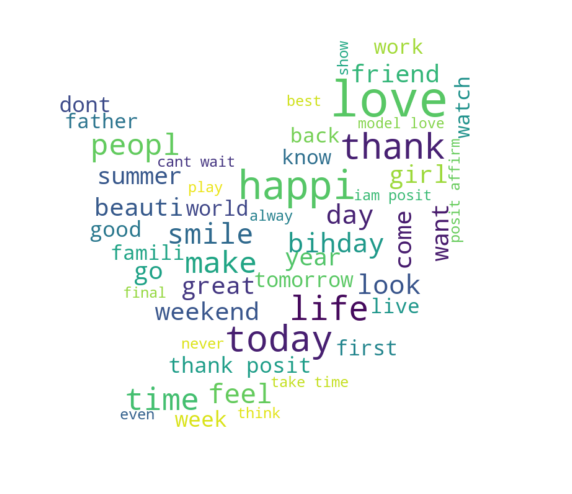

In [38]:
plot_wordcloud(all_words)

4. Visualize the wordcloud just for the text from the tweets identified as hate speech. 

    Similarly, you need to stitch all the tidy tweets in training set that were identified as hate speech. 
    Save the long string to `negative_words`.

In [39]:
negative_words = ' '.join(raw[raw['label'] == 1]['tidy_tweet'])

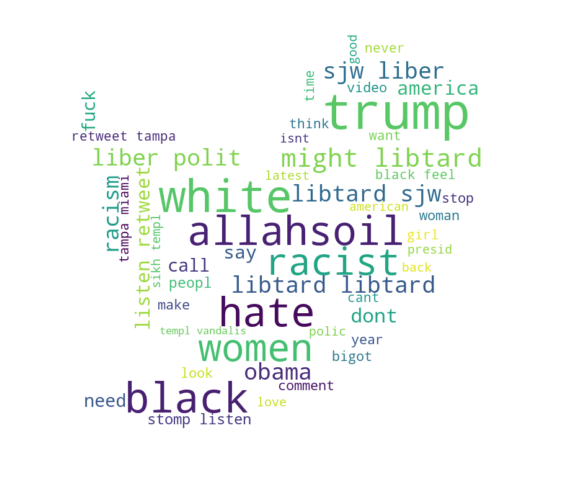

In [40]:
plot_wordcloud(negative_words)

In [42]:
positive_words = ' '.join(raw[raw['label'] == 0]['tidy_tweet'])

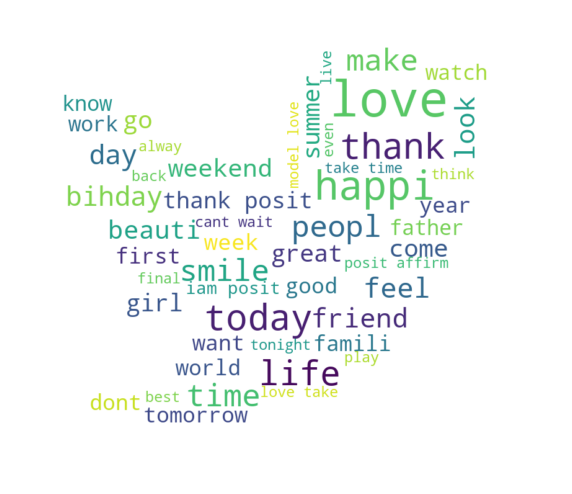

In [43]:
plot_wordcloud(positive_words)

5. Hashtag is a feature for tweets and we would like to inspect if hashtags provide information for our classification task. 

    Function `hashtag_extract` is provided to extract hashtags from an iterable (list or series) and return the hashtags in a list. 

In [44]:
def hashtag_extract(x) -> list:
    """
    extract hastags from an iterable (list or series) and 
    return the hashtags in a list.
    """
    hashtags = []
    # Loop over the words in the tweet
    for i in x:
        ht = re.findall(r"#(\w+)", i)
        hashtags.append(ht)
    return hashtags

6. Extract hashtags from non-hate speech tweets.

In [45]:
HT_regular = hashtag_extract(raw[raw['label'] == 0]['tidy_tweet']) 

In [46]:
assert type(HT_regular) == list
assert type(HT_regular[0]) == list # nested list

7. Now extract hashtags from hate speech tweets.

In [47]:
HT_negative = hashtag_extract(raw[raw['label'] == 1]['tidy_tweet']) 

8. Both `HT_regular` and `HT_negative` are nested lists, so use the following trick to unnest both lists.

In [54]:
HT_regular = sum(HT_regular,[])
HT_negative = sum(HT_negative,[])

In [55]:
assert type(HT_regular) == type(HT_negative) == list
assert type(HT_regular[0]) == type(HT_negative[0]) == str

9. Complete the function `top_hashtags` below to take a list of hashtags and return the top `n` hashtag keyword and its frequncy. 

In [56]:
from typing import List, Tuple
from collections import Counter
def top_hashtags(hashtags:List[str], n=10) -> List[Tuple[str, int]]:
    ''' Function to return the top n hashtags '''
    freq = Counter(hashtags) 
    d = pd.DataFrame({'Hashtag': list(freq.keys()),
                  'Count': list(freq.values())})
    
    # selecting top n most frequent hashtags     
    d = d.nlargest(columns="Count", n = n) 
    return d

1. Apply the function to the hashtag lists from the non-hate speech tweets and the hate speech tweets.

In [57]:
top_hashtags(HT_regular)

,Hashtag,Count
32,love,1638
40,posit,917
59,smile,674
158,healthi,572
39,thank,534
177,fun,461
94,affirm,423
347,life,422
290,summer,385
4,model,375


In [58]:
top_hashtags(HT_negative)

,Hashtag,Count
22,trump,136
31,polit,95
63,allahsoil,92
30,liber,81
28,libtard,77
29,sjw,74
60,retweet,63
59,black,46
62,miami,46
33,hate,37


10. DISCUSS: are these hashtags making sense? should we include them as features or should we strip the # before tokenizing (that is, treat "#love" the same as "love")? why and why not?


Hashtags for the "regular" tweets have words such as love, posit (positive), smile, healthi etc that indeed are non-hate. For the "negative" tweets, there is trump, polit (political), libtard etc that are indeed related to hate tweets. So yes, we should include the hashtags as features in the classification, because they seem correlated with the regular vs negative class. 

# Task 3. Features

Note that almost all the machine learning related Python modules expect numerical presentation of data; thus we need to transform our text first.
We will experiment with bag of words, tf-idf, and word2vec.  

1. Convert the collection of text documents to a matrix of token counts.

    Check the [official documentation](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html). 
    
    Create an instance of `CountVectorizer` named `bow_vectorizer`, set `max_features` to be `MAX_FEATURES`.
    Learn the vocabulary dictionary and return document-term matrix and save it to `bow_train`. Use `.fit_transform`. 

In [59]:
from sklearn.feature_extraction.text import CountVectorizer
MAX_FEATURES = 1000

bow_vectorizer = CountVectorizer(max_features=MAX_FEATURES) 
bow_train = bow_vectorizer.fit_transform(X_train) 

In [61]:
# document-term matrix has MAX_FEATURES columns for each input text
assert bow_train.shape == (X_train.shape[0], MAX_FEATURES)

2. Print the first three rows from `bow_train`. Hint: `.toarray()`.

In [62]:
bow_train.toarray()[0:3]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [63]:
# get tidy tweet at loc 1
X_train.iloc[1]

'watch made america simpson interest went still go'

In [64]:
# bag-of-words matrix has non-zero values for columns representing the words in the text 
# print the indices of nonzero values 
print(bow_train[1].nonzero())

(array([0, 0, 0, 0, 0, 0, 0], dtype=int32), array([945, 519,  30, 439, 958, 814, 355], dtype=int32))


In [70]:
# find the word associated with first index 
first_index = bow_train[1].nonzero()[1][0]
bow_vectorizer.get_feature_names_out()[first_index]

'watch'

In [72]:
# get the document-matrix value - frequency count of word in that text
bow_train[1].toarray()[0][first_index]

1

In [73]:
# bag-of-words matrix is stored as a compressed representation (csr_matrix)
from scipy.sparse.csr import csr_matrix
assert type(bow_train) == csr_matrix

3. Similarly, convert the collection of text documents to a matrix of TF-IDF features.
    
    Create an instance of [`TfidfVectorizer`](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html#sklearn.feature_extraction.text.TfidfVectorizer) named `tfidf_vectorizer`, set `max_features` to be `MAX_FEATURES`.

    Learn the vocabulary and idf, return document-term matrix and save it to `tfidf_train`. 

In [75]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer(max_features=MAX_FEATURES, stop_words='english')  # YOUR CODE HERE
tfidf_train = tfidf_vectorizer.fit_transform(X_train)

In [76]:
assert type(tfidf_train) == csr_matrix
assert tfidf_train.shape == bow_train.shape == (X_train.shape[0], MAX_FEATURES)

In [78]:
# get tidy tweet at loc 1
X_train.iloc[1]

'watch made america simpson interest went still go'

In [83]:
# tf-idf matrix has non-zero values of weighted counts for terms (tf-idf values) for columns representing the corresponding words in the text 
# print the indices of nonzero values 
print(tfidf_train[1].nonzero())

(array([0, 0, 0], dtype=int32), array([961,  29, 949], dtype=int32))


In [92]:
# find the word 'watch'
idx = tfidf_train[1].nonzero()[1][2]
tfidf_vectorizer.get_feature_names_out()[idx]

'watch'

In [93]:
# tf-idf value for term 
tfidf_train[1].toarray()[0][idx]

0.49566146808269135

Bag-of-words gives actual frequency. In the sentence `watch made america simpson interest went still go`, for `watch` it is 1. TF-IDF is a weighted frequency count. Now for `watch` it is 0.5. 

4. Extract word embeddings using Word2Vec. 
We will use [`gensim`](https://radimrehurek.com/gensim/auto_examples/tutorials/run_word2vec.html) for this task. 
    
    The Word2Vec model takes either a list of lists of tokens or an iterable that streams the sentences directly from disk/network. 
    Here, we tokenize the tidy tweets in `X_train` and save the list (`pd.series`) of lists of tokens to `tokenized_tweet`. 

In [94]:
tokenized_tweet = X_train.apply(lambda x: x.split()) # tokenizing

In [95]:
assert tokenized_tweet.shape == X_train.shape

In [97]:
tokenized_tweet.iloc[1]

['watch', 'made', 'america', 'simpson', 'interest', 'went', 'still', 'go']

5. Import `Word2Vec` from `gensim.models`; see [doc](https://radimrehurek.com/gensim/models/word2vec.html#gensim.models.word2vec.Word2Vec). 

    Create a skip-gram `Word2Vec` instance named `w2v` that learns on the `tokenized_tweet`, with `vector_size` set at `MAX_FEATURES`, and other parameters are provided. 

In [98]:
from gensim.models import Word2Vec

In [100]:
w2v = Word2Vec(
        sentences = tokenized_tweet,
        vector_size = MAX_FEATURES,
        window=5, min_count=2, sg = 1, 
        hs = 0, negative = 10,  workers= 2, 
        seed = 34)

6. Train the skip-gram model, set the epochs at 20.

In [101]:
%%time

w2v.train(tokenized_tweet, total_examples=len(tokenized_tweet), epochs=20)

CPU times: user 2min 7s, sys: 137 ms, total: 2min 7s
Wall time: 1min 6s


(2752113, 3266220)

In [120]:
word = "watch"
vector = w2v.wv[word]
print(len(vector)) #vector is of length MAX_FEATURES 

1000


7. Let's see how the model performs. 
Specify a word and print out the 10 most similar words from the our tweets in the training set. 
Use [`most_similar`](https://radimrehurek.com/gensim/models/keyedvectors.html#gensim.models.keyedvectors.KeyedVectors.most_similar). 
Hint: print the type of `w2v` and `w2v.wv`.

In [103]:
type(w2v)

gensim.models.word2vec.Word2Vec

In [104]:
type(w2v.wv)

gensim.models.keyedvectors.KeyedVectors

In [116]:
w2v.wv.most_similar(positive=['democrat'])

[('latina', 0.8771811127662659),
 ('#barrackobama', 0.8579435348510742),
 ('islamist', 0.8502599596977234),
 ('#bernieorbust', 0.8479422330856323),
 ('migrant', 0.8470547795295715),
 ('isra', 0.8404437899589539),
 ('elitist', 0.8393754363059998),
 ('nomine', 0.8374634385108948),
 ('textbook', 0.8325999975204468),
 ('biher', 0.8293471336364746)]

8. Discuss: how does w2v calculate the similarities? 

Word2Vec converts a word to a vector representation. In this case, we have specified the vector lenth as MAX_FEATURES. To find the similarity between 2 words, we compute the cosine similarity measure, i.e the cosine of the angle between the 2 corresponding vector representations. If the cosine is 1, angle is 0, and the vectors are in the same direction, with the highest similarity. If cosine is -1, angle is 180 degrees, and so the vectors are in opposite directions with no similarity.

9. Discuss: do you think Word2Vec is supervised or unsupervised ML technique?

Word2Vec is an unsupervised learning method as it uses only the raw text and does not require any labels. We only provided `tokenized_tweet` and no labels and the model learnt the embeddings. 

10. Engineer features. 

    For each tweet, we calculate the average of embeddings (function `word_vector`) and then apply it to every tidy tweet in `X_train` (use function `tokens_to_array`).
    Both functions are provided, inspect the code and save the features in `w2v_train`.

In [121]:
from gensim.models.keyedvectors import KeyedVectors

def word_vector(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    vec = np.zeros(size).reshape((1, size))
    count = 0
    for word in tokens:
        try:
            vec += keyed_vec[word].reshape((1, size))
            count += 1
        except KeyError: 
            # handling the case where the token is not in vocabulary        
            continue
    if count != 0:
        vec /= count
    return vec

def tokens_to_array(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    array = np.zeros((len(tokens), size))
    for i in range(len(tokens)):
        array[i,:] = word_vector(tokens.iloc[i], size, keyed_vec=keyed_vec)
    return array

In [122]:
w2v_train = tokens_to_array(tokenized_tweet, size=MAX_FEATURES) 

In [123]:
assert w2v_train.shape == (X_train.shape[0], MAX_FEATURES)

11. Prepare the test data before modeling for each approach:


  - extract features from `X_test` using the bag of words approach; use `bow_vectorizer`
  - extract features from `X_test` using the tf-idf approach; use `tfidf_vectorizer`
  - extract features from `X_test` using Word2Vec embeddings; you need to first tokenized the tidy tweets in `X_test`, then convert the tokens to array of shape `(X_test.shape[0], MAX_FEATURES)`.

In [125]:
bow_test = bow_vectorizer.fit_transform(X_test) #Bag of words features test data 
tfidf_test = tfidf_vectorizer.fit_transform(X_test) #TF-IDF features test data 
tokenized_tweet_test = X_test.apply(lambda x: x.split()) # tokenizing
w2v_test = tokens_to_array(tokenized_tweet_test, size=MAX_FEATURES) #Word2Vec test data

In [126]:
assert bow_test.shape == tfidf_test.shape == w2v_test.shape == (X_test.shape[0], MAX_FEATURES)

# Task 4. Naive Bayes classifiers

In this task, you will build a [naive Bayes](https://sebastianraschka.com/Articles/2014_naive_bayes_1.html) (here's another [ref](https://www.inf.ed.ac.uk/teaching/courses/inf2b/learnnotes/inf2b-learn07-notes-nup.pdf)), classifiers to identify the hate speech tweets using different sets of features from the last task, and evaluate their performances. 

In the era of deep learning, naive Bayes is useful due to its simplicity and reasonable performance, especially if there is not much training data available. A common interview question is "Why is naive Bayes naive?". 

We will use multi-variate Bernoulli naive Bayes [`BernoulliNB`](https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.BernoulliNB.html); try other flavors of [naive Bayes](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.naive_bayes) if time permits. Code is pretty straightforward. 

1. Import `BernoulliNB` for modeling and `classification_report` for reporting performance. 

In [127]:
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import classification_report

In [153]:
raw_analyse = pd.DataFrame({'tweet': X_test, 'label': y_test})

In [154]:
raw_analyse.head(10)

,tweet,label
15655,true life tough sometim feel helpless heabreak...,0
21614,mate address argument rather #troll #staup #rude,0
3197,surpris read make gtgtgt betray ltltlt #scifi ...,0
12314,father,0
8633,#fathersday gift proud dadsavail,0
26615,#newsghana request christina grimmi brother fa...,0
29341,page #thedescend rewrit almost halfway point #...,0
14149,friday call weekend friday thursday call text ...,0
21608,#love #sydney #vividsydney #sydneyoperahous #h...,0
22051,#anc quick #shit zill comment note black racist,1


2. Create an instance of  `BernoulliNB` named `BNBmodel`. 

    We can use it for all three feature sets.

In [156]:
BNBmodel = BernoulliNB()

3. Train the multi-variate Bernoulli naive Bayes using bag of words features and print the performance report.

In [157]:
BNBmodel.fit(bow_train, y_train)

BernoulliNB()

In [158]:
y_true = y_test 
y_pred = BNBmodel.predict(bow_test)
raw_analyse['nb_bow'] = y_pred
target_names = ['regular', 'hate']
print(classification_report(y_true, y_pred, target_names=target_names))

              precision    recall  f1-score   support

     regular       0.94      0.97      0.95      7430
        hate       0.24      0.12      0.16       561

    accuracy                           0.91      7991
   macro avg       0.59      0.55      0.56      7991
weighted avg       0.89      0.91      0.90      7991



In [174]:
raw_analyse[(raw_analyse['label'] == 1) & (raw_analyse['nb_bow'] == 0)]

,tweet,label,nb_bow,nb_tfidf,nb_w2v
22051,#anc quick #shit zill comment note black racist,1,0,0,1
29970,kind expect #trump amrica,1,0,0,1
23135,#obamalegaci show negat stuff confus #obama #p...,1,0,0,1
15634,look like brother whos first wife found wanoth...,1,0,0,0
24901,free porn thailand white girl black,1,0,0,1
...,...,...,...,...,...
13306,#allahsoil bear rapaci hunger also seal doom #...,1,0,0,1
8913,serious consid perform inaugur #li #misogynist,1,0,1,1
7556,#blackpeopl beat #whiteperson isnt might make ...,1,0,0,1
4435,hell juan decid kellyann rais kid work weve ye...,1,0,0,0


4. Similarly, train the model using tf-idf features and print the performance report. 

    Is the performance expected? Why or why not?

In [166]:
BNBmodel.fit(tfidf_train, y_train)

BernoulliNB()

In [167]:
y_true = y_test
y_pred = BNBmodel.predict(tfidf_test)
raw_analyse['nb_tfidf'] = y_pred
target_names = ['regular', 'hate']
print(classification_report(y_true, y_pred, target_names=target_names))

              precision    recall  f1-score   support

     regular       0.93      0.95      0.94      7430
        hate       0.15      0.12      0.13       561

    accuracy                           0.89      7991
   macro avg       0.54      0.53      0.54      7991
weighted avg       0.88      0.89      0.89      7991



In [173]:
raw_analyse[(raw_analyse['label'] == 1) & (raw_analyse['nb_tfidf'] == 0)]

,tweet,label,nb_bow,nb_tfidf,nb_w2v
22051,#anc quick #shit zill comment note black racist,1,0,0,1
29970,kind expect #trump amrica,1,0,0,1
23135,#obamalegaci show negat stuff confus #obama #p...,1,0,0,1
15634,look like brother whos first wife found wanoth...,1,0,0,0
24901,free porn thailand white girl black,1,0,0,1
...,...,...,...,...,...
27121,girl mayb gender neutral teenag,1,0,0,1
13306,#allahsoil bear rapaci hunger also seal doom #...,1,0,0,1
7556,#blackpeopl beat #whiteperson isnt might make ...,1,0,0,1
4435,hell juan decid kellyann rais kid work weve ye...,1,0,0,0


5. Finally, train the model using Word2Vec embeddings and report the performance. 

In [170]:
BNBmodel.fit(w2v_train, y_train)
y_pred = BNBmodel.predict(w2v_test)
raw_analyse['nb_w2v'] = y_pred
target_names = ['regular', 'hate']
print(classification_report(y_true, y_pred, target_names=target_names))

              precision    recall  f1-score   support

     regular       0.98      0.84      0.91      7430
        hate       0.28      0.81      0.42       561

    accuracy                           0.84      7991
   macro avg       0.63      0.83      0.66      7991
weighted avg       0.93      0.84      0.87      7991



In [172]:
raw_analyse[(raw_analyse['label'] == 1) & (raw_analyse['nb_w2v'] == 0)]

,tweet,label,nb_bow,nb_tfidf,nb_w2v
15634,look like brother whos first wife found wanoth...,1,0,0,0
25629,,1,0,0,0
18746,almost alway trust brazilian,1,0,0,0
3303,hour walk #nyc woman #newyork #women #men #bigot,1,0,1,0
17180,real time back #smackdown #unitedstateschampio...,1,0,0,0
...,...,...,...,...,...
30397,tell stori #videogam specif #marvel super hero...,1,0,0,0
2750,happen often,1,0,0,0
21792,delet account shallow away,1,0,0,0
12716,#selfi #love #messi #religion #christian #meccal,1,0,0,0


6. Discuss the differences in performance using tf-idf vs skim-gram embeddings. 

The class imbalance between hate and regular tweets seems to affect both the features, with f1-scores of hate tweets being substantially lower than those of regular tweets. 

The skip gram embeddings with Word2Vec have a better performance for the hate tweets with f1-score of 0.42 vs 0.13 with tf-idf. 

However, the f1-score of regular tweets is slightly lower for skip gram embeddings at 0.91 vs 0.94 with tf-idf. 



7. Examine a few tweets where the model(s) failed. 
What other features would you include in the next iteration?

* All 3 models failed to classify 99 hate tweets correctly. 
* All 3 models failed to classify 12 regular tweets correctly. 

In the next iteration, we could use the length of tweet and hashtags as additional features. 

In [175]:
raw_analyse[(raw_analyse['label'] == 1) & (raw_analyse['nb_bow'] == 0) & (raw_analyse['nb_tfidf'] == 0) & (raw_analyse['nb_w2v'] == 0)]

,tweet,label,nb_bow,nb_tfidf,nb_w2v
15634,look like brother whos first wife found wanoth...,1,0,0,0
25629,,1,0,0,0
18746,almost alway trust brazilian,1,0,0,0
17180,real time back #smackdown #unitedstateschampio...,1,0,0,0
14565,team #new show #phillysuppophilli combat,1,0,0,0
...,...,...,...,...,...
30397,tell stori #videogam specif #marvel super hero...,1,0,0,0
2750,happen often,1,0,0,0
21792,delet account shallow away,1,0,0,0
12716,#selfi #love #messi #religion #christian #meccal,1,0,0,0


In [176]:
raw_analyse[(raw_analyse['label'] == 0) & (raw_analyse['nb_bow'] == 1) & (raw_analyse['nb_tfidf'] == 1) & (raw_analyse['nb_w2v'] == 1)]

,tweet,label,nb_bow,nb_tfidf,nb_w2v
316,stalk watch peon poor disabl kill methi #usa u...,0,1,1,1
25850,cant believ american would vote mani scandal,0,1,1,1
6775,mani claim matur high level discern manipul un...,0,1,1,1
9022,trump campaign manag tweet fake poll trump soo...,0,1,1,1
16365,trump clinton lead american choos lesser evil ...,0,1,1,1
2802,confirm teacher youth director interest meet #...,0,1,1,1
13562,return holiday cornwal heard unfoun comment ra...,0,1,1,1
7933,compani allow peopl critic truli success,0,1,1,1
14337,uncommon area polic area mani year homicidessh...,0,1,1,1
15934,mani act #terror homeland #obama presid mani d...,0,1,1,1


# Task 5. Bidirectional LSTM 

In this task, you will build a bidirectional LSTM (BiLSTM) model to detect tweets identified as hate speech, and visualize the embedding layer using Tensorboard projector. 

Why BiLSTM? LSTM, at its core, preserves information from inputs that has already passed through it using the hidden state. Unidirectional LSTM only preserves information of the past because the only inputs it has seen are from the past. BiLSTMs run inputs in both ways, one from past to future and one from future to past and show very good results as they can understand context better [ref](https://stackoverflow.com/questions/43035827/whats-the-difference-between-a-bidirectional-lstm-and-an-lstm).

1. Tokenizing and padding. 
    
    As LSTM expects every sentence to be of the same length, in addition to [`Tokenizer`](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer) with a given number of vocabulary `VOCAB_SIZE`, we need to [pad](https://www.tensorflow.org/api_docs/python/tf/keras/utils/pad_sequences) shorter tweets with 0s until the length is `MAX_LEN` and truncate longer tweets to be exact `MAX_LEN` long. 
    
   Function `tokenize_pad_sequences` is provided except that you need to supply correct `num_words` and `filters`; do NOT filter `#`. 
   
   We feed the processed `tidy_tweet` to `tokenize_pad_sequences`, but one can perform the preprocessing steps in `Tokenizer` and apply it directly on the raw tweets.

In [177]:
VOCAB_SIZE = 25000  
MAX_LEN = 50

In [178]:
import tensorflow as tf
from tensorflow import keras

from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences

def tokenize_pad_sequences(text):
    '''
    tokenize the input text into sequences of integers and then
    pad each sequence to the same length
    '''
    # Text tokenization
    tokenizer = Tokenizer(
        num_words=VOCAB_SIZE,
        filters='', # tidy_tweet is already processed so we don't add any filters here
        lower=True, split=' ', oov_token='oov')
    tokenizer.fit_on_texts(text)
    # Transforms text to a sequence of integers
    X = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    X = pad_sequences(X, padding='post', maxlen=MAX_LEN)

    return X, tokenizer

In [179]:
print('Before Tokenization & Padding \n', raw['tidy_tweet'][0])
X, tokenizer = tokenize_pad_sequences(raw['tidy_tweet'])
print('After Tokenization & Padding \n', X[0])
y = raw['label'].values

Before Tokenization & Padding 
 father dysfunct selfish drag kid dysfunct #run
After Tokenization & Padding 
 [  15 6464 2997 1683  218 6464  463    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


2. Let's split `X` into training and testing datasets, save 25% for testing. 
Then split training dataset into training and validation datasets, with 20% for validation. 
Set both `random_state` to be 42. 
Stratify both splits. 

In [181]:
X_train, X_test, y_train, y_test = train_test_split(
    X, 
    y, 
    test_size=0.25, 
    random_state=42, 
    stratify=y
    )

X_train, X_val, y_train, y_val = train_test_split(
    X_train, 
    y_train, 
    test_size=0.2, 
    random_state=42, 
    stratify=y_train
    )

In [182]:
print('Train Set ->', X_train.shape, y_train.shape)
print('Validation Set ->', X_val.shape, y_val.shape)
print('Test Set ->', X_test.shape, y_test.shape)

Train Set -> (19176, 50) (19176,)
Validation Set -> (4795, 50) (4795,)
Test Set -> (7991, 50) (7991,)


3. Now build a sequential model:

    - an embedding layer
    - a bidirectional LSTM with 32 units and set `return_sequences=True` in LSTM
    - a global average pooling operation for temporal data
    - a dropout layer with 20% rate
    - a dense layer of 32 units and set the activation function to be ReLu
    - a dense layer of 1 unit and set the proper activation function for classification

In [183]:
from keras.models import Sequential
from keras.layers import Embedding, LSTM, Bidirectional, GlobalAveragePooling1D, Dropout, Dense
EMBEDDING_DIM = 16   
model = Sequential([
    Embedding(input_dim=VOCAB_SIZE, output_dim=EMBEDDING_DIM, input_length=MAX_LEN),
    Bidirectional(LSTM(32, return_sequences=True)),
    GlobalAveragePooling1D(), 
    Dropout(0.20), 
    Dense(32, activation='relu'), 
    Dense(1, activation='sigmoid')
])

In [184]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 50, 16)            400000    
                                                                 
 bidirectional (Bidirectiona  (None, 50, 64)           12544     
 l)                                                              
                                                                 
 global_average_pooling1d (G  (None, 64)               0         
 lobalAveragePooling1D)                                          
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense (Dense)               (None, 32)                2080      
                                                                 
 dense_1 (Dense)             (None, 1)                 3

4. Compile the model. 

    Fill in a proper loss function and use adam as the optimizer. 
    For metrics, include precision and recall in the metrics, in addition to accuracy. 

In [185]:
from keras.metrics import Precision, Recall
model.compile(
    loss='binary_crossentropy',
    optimizer='adam', 
    metrics=['accuracy', Precision(), Recall()]
    ) 

5. Train the model for 10 epochs on training dataset with a  validation set.

In [186]:
EPOCHS=10
BATCH_SIZE = 32
history = model.fit(X_train, y_train,
                    validation_data=(X_val, y_val),
                    batch_size=BATCH_SIZE, epochs=EPOCHS, verbose=2)

Epoch 1/10
600/600 - 34s - loss: 0.2159 - accuracy: 0.9362 - precision: 0.6290 - recall: 0.2193 - val_loss: 0.1369 - val_accuracy: 0.9525 - val_precision: 0.6753 - val_recall: 0.6190 - 34s/epoch - 56ms/step
Epoch 2/10
600/600 - 25s - loss: 0.0878 - accuracy: 0.9718 - precision: 0.8509 - recall: 0.7257 - val_loss: 0.1340 - val_accuracy: 0.9587 - val_precision: 0.8594 - val_recall: 0.4911 - 25s/epoch - 41ms/step
Epoch 3/10
600/600 - 29s - loss: 0.0511 - accuracy: 0.9856 - precision: 0.9238 - recall: 0.8654 - val_loss: 0.1507 - val_accuracy: 0.9541 - val_precision: 0.6859 - val_recall: 0.6369 - 29s/epoch - 48ms/step
Epoch 4/10
600/600 - 25s - loss: 0.0350 - accuracy: 0.9897 - precision: 0.9484 - recall: 0.9026 - val_loss: 0.1526 - val_accuracy: 0.9566 - val_precision: 0.7162 - val_recall: 0.6310 - 25s/epoch - 41ms/step
Epoch 5/10
600/600 - 25s - loss: 0.0244 - accuracy: 0.9933 - precision: 0.9663 - recall: 0.9375 - val_loss: 0.1738 - val_accuracy: 0.9595 - val_precision: 0.7689 - val_reca

In [187]:
# Save history 

import json
# Get the dictionary containing each metric and the loss for each epoch
history_dict = history.history
# Save it under the form of a json file
json.dump(history_dict, open('/content/drive/MyDrive/fourthbrain/Week-10/lstm_training_history', 'w'))

# Save model 
model.save('/content/drive/MyDrive/fourthbrain/Week-10/lstm_model')


In [188]:
history_dict = json.load(open('/content/drive/MyDrive/fourthbrain/Week-10/lstm_training_history', 'r'))

In [189]:
model_l = keras.models.load_model('/content/drive/MyDrive/fourthbrain/Week-10/lstm_model')

6. Function `plot_graphs` is provided below to visualize how the performance of model progresses as a function of epoch. 

    Visualize accuracy and loss. 

In [191]:
def plot_graphs(history, metric):
  fig, ax = plt.subplots()
  plt.plot(history.history[metric])
  plt.plot(history.history['val_'+metric], '')
  ax.set_xticks(range(EPOCHS))
  plt.xlabel("Epochs")
  plt.ylabel(metric)
  plt.legend([metric, 'val_'+metric])

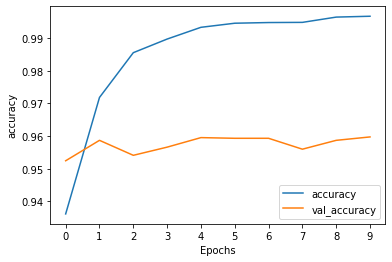

In [192]:
plot_graphs(history, 'accuracy')

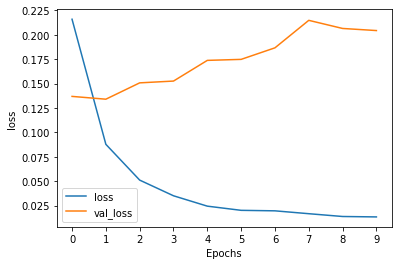

In [193]:
plot_graphs(history, 'loss')

7. The model starts to overfit after a couple of epochs. 
Consider using [early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) to stop training when a monitored metric has stopped improving. 

  What can we do to tame overfitting?

We can use drop out layers and early stopping to tame overfitting. Below we stop early after 3 epochs to prevent the model from overfitting. 

In [194]:
callbacks = [
    keras.callbacks.EarlyStopping(
        # Stop training when `val_loss` is no longer improving
        monitor="val_loss",
        # "no longer improving" being defined as "no better than 1e-2 less"
        min_delta=1e-2,
        # "no longer improving" being further defined as "for at least 2 epochs"
        patience=2,
        verbose=1,
    )
]
model.fit(
    X_train, 
    y_train,
    validation_data=(X_val, y_val),
    batch_size=BATCH_SIZE, 
    callbacks=callbacks,
    epochs=EPOCHS, 
    verbose=2
    )

Epoch 1/10
600/600 - 25s - loss: 0.0114 - accuracy: 0.9969 - precision: 0.9777 - recall: 0.9777 - val_loss: 0.2248 - val_accuracy: 0.9570 - val_precision: 0.7226 - val_recall: 0.6280 - 25s/epoch - 41ms/step
Epoch 2/10
600/600 - 26s - loss: 0.0129 - accuracy: 0.9966 - precision: 0.9827 - recall: 0.9688 - val_loss: 0.2492 - val_accuracy: 0.9397 - val_precision: 0.5589 - val_recall: 0.6637 - 26s/epoch - 43ms/step
Epoch 3/10
600/600 - 25s - loss: 0.0125 - accuracy: 0.9966 - precision: 0.9727 - recall: 0.9784 - val_loss: 0.2660 - val_accuracy: 0.9539 - val_precision: 0.7032 - val_recall: 0.5923 - 25s/epoch - 42ms/step
Epoch 3: early stopping


8. Print the classification report of the model on test dataset. 

In [120]:
y_true = y_test
y_pred = (model.predict(X_test) > 0.5).astype(int)

print(classification_report(y_true, y_pred, target_names=target_names))

250/250 [==============================] - 2s 10ms/step
              precision    recall  f1-score   support

     regular       0.97      0.97      0.97      7430
        hate       0.63      0.64      0.64       561

    accuracy                           0.95      7991
   macro avg       0.80      0.81      0.81      7991
weighted avg       0.95      0.95      0.95      7991



9. Discuss: how does the BiLSTM model improve the classification over naive Bayes? 

The class imbalance between hate and regular tweets continues to affect the BiLSTM as well, with f1-scores of hate tweets being lower than those of regular tweets. 

The BiLSTM has a better performance for the hate tweets with f1-score of 0.64 vs 0.42 with skip gram embeddings/Naive-Bayes. 

However, the f1-score of regular tweets is also slightly improved for BiLSTM at 0.97 vs 0.94 with tf-idf/Naive-Bayes. 


In [ ]:
# # NB using tf-idf
#               precision    recall  f1-score   support

#            0       0.96      0.97      0.97      7430
#            1       0.55      0.48      0.51       561

#     accuracy                           0.94      7991
#    macro avg       0.75      0.72      0.74      7991
# weighted avg       0.93      0.94      0.93      7991

# # NB using word2vec
#               precision    recall  f1-score   support

#            0       0.98      0.85      0.91      7430
#            1       0.29      0.82      0.43       561

#     accuracy                           0.85      7991
#    macro avg       0.64      0.83      0.67      7991
# weighted avg       0.94      0.85      0.88      7991

10. Visualize embeddings using [Embedding Projector](https://www.tensorflow.org/tensorboard/tensorboard_projector_plugin) in Tensorboard. 
The setup for Tensorboard can be tricky, most of the code is provided. 

    TensorBoard reads tensors and metadata from the logs of your tensorflow projects. 
    The path to the log directory is specified with log_dir below. 
    
    In order to load the data into Tensorboard, we need to save a training checkpoint to that directory, along with metadata that allows for visualization of a specific layer of interest in the model.

    Load the TensorBoard notebook extension and import `projector` from `tensorboard.plugins`.

In [199]:
%load_ext tensorboard

In [200]:
from tensorboard.plugins import projector

11. Clear any logs from previous runs if any.

In [201]:
rm -rf /logs/  

12. Set up a logs directory, so Tensorboard knows where to look for data.

In [202]:
import os
log_dir='/logs/tweets-example/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

13. Save the first `VOCAB_SIZE` most frequent words in the vocabulary as `metadata.tsv`.

In [203]:
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  i = 0
  for label in tokenizer.word_index.keys():
    if label == 'oov':
      continue # skip oov
    f.write("{}\n".format(label))
    if i > VOCAB_SIZE:
      break
    i += 1

14. Save the weights we want to analyze as a variable. Note that the first value represents any unknown word, which is not in the metadata, here we will remove this value.

In [204]:
weights = tf.Variable(model.layers[0].get_weights()[0][1:]) # `embeddings` has a shape of (num_vocab, embedding_dim) 

15. Create a checkpoint from embedding, the filename and key are the name of the tensor.

In [205]:
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

'/logs/tweets-example/embedding.ckpt-1'

16. Set up config.

In [206]:
config = projector.ProjectorConfig()
embedding = config.embeddings.add()

17. The name of the tensor will be suffixed by `/.ATTRIBUTES/VARIABLE_VALUE`.

In [207]:
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

18. Verify the following files exist under the current directory

In [208]:
ls /logs/tweets-example/

checkpoint                            metadata.tsv
embedding.ckpt-1.data-00000-of-00001  projector_config.pbtxt
embedding.ckpt-1.index


19. Now run Tensorboard against on log data we just saved. 

    You may need to run this cell **twice** to see the projector correctly. 
    Use Chrome for least friction.

In [210]:
%tensorboard --logdir /logs/tweets-example/

Reusing TensorBoard on port 6006 (pid 59042), started 0:00:06 ago. (Use '!kill 59042' to kill it.)

<IPython.core.display.Javascript object>

The TensorBoard Projector can be a great tool for interpreting and visualzing embedding. The dashboard allows users to search for specific terms, and highlights words that are adjacent to each other in the embedding (low-dimensional) space. Try a few word in the Search box and see if the embeddings make sense. 

# Task 6. Interpretation

Lastly let's try to understnad predictions by BiLSTM using a model agnostic approach -- [Local interpretable model-agnostic explanations (LIME)](https://christophm.github.io/interpretable-ml-book/lime.html)

1. Import `LimeTextExplainer` from the [`lime_text`](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_text) module in package [`lime`](https://github.com/marcotcr/lime)

In [211]:
from lime.lime_text import LimeTextExplainer

2. Create an instance of `LimeTextExplainer`, call it `explanier`. 

In [212]:
explainer = LimeTextExplainer(class_names=['regular', 'hate'], random_state=2)

3. Method `explain_instance` expects the `classifier_fn` to be a function, we provide the function `predict_proba` as below. 

In [213]:
def predict_proba(arr):
    processed = tokenizer.texts_to_sequences(arr)
    processed = pad_sequences(processed, padding='post', maxlen=MAX_LEN)
    pred = model.predict(processed)
    r = []
    for i in pred:
        temp = i[0]
        r.append(np.array([1-temp,temp])) 
    return np.array(r)

4. Read about [`explain_instance`](https://lime-ml.readthedocs.io/en/latest/lime.html#lime.lime_text.LimeTextExplainer.explain_instance). 

    Create an instance named `exp` to explain the 16399th tidy tweet from the original dataset, i.e., `raw.tidy_tweet.iloc[16399]`. 

In [214]:
idx = 16399 
sample_tweet = raw.tidy_tweet.iloc[idx]
exp = explainer.explain_instance(
    sample_tweet, 
    predict_proba,
    num_features=6)

exp.show_in_notebook(text=sample_tweet)

157/157 [==============================] - 3s 11ms/step


5. Pick another random tweet and generate explanations for the prediction.

In [223]:
idx = 1000 
sample_tweet = raw.tidy_tweet.iloc[idx]
exp = explainer.explain_instance(
    sample_tweet, 
    predict_proba,
    num_features=6)

exp.show_in_notebook(text=sample_tweet)

157/157 [==============================] - 3s 20ms/step


6. Jot down your observations in explaining the model. 

LIME explanations break down the contribution of each word to the tweet being classified as `regular` or `hate`. In the first example "plethora" is a neutral word but contributes significantly (compared to the word "racist" which is closer to a `hate` tweet) to the tweet being classified as `hate`. It would be good to investigate this more. 


For the second tweet, "london" is contributes positives to `regular` but "europe" does not. Overall the tweet is classified as `regular`. It will be interesting to see why there is this discrepancy in the contributions between these two words that otherwise seem related. 

# Acknowledgement & Reference

- Data is adapted from [Twitter sentiment analysis](https://datahack.analyticsvidhya.com/contest/practice-problem-twitter-sentiment-analysis/#ProblemStatement)
- [Twitter sentiment analysis](https://github.com/prateekjoshi565/twitter_sentiment_analysis/blob/master/code_sentiment_analysis.ipynb) 
- [Introduction to Word Embedding and Word2Vec](https://towardsdatascience.com/introduction-to-word-embedding-and-word2vec-652d0c2060fa)
- [When to use GRU over LSTM?](https://datascience.stackexchange.com/questions/14581/when-to-use-gru-over-lstm)
- Use a trained Word2Vec, Doc2Vec or FastTest embedding by `gensim` in buiding an embedding layers in Tensorflow, here's [how-to](https://github.com/RaRe-Technologies/gensim/wiki/Using-Gensim-Embeddings-with-Keras-and-Tensorflow).

## Answers to Rubrics Questions 

#### Algorithm Understanding
How does the Naive Bayes Classifier work?
What is Posterior Probability?

Naive Bayes classifier is based on the Bayes theorem. The theorem computes the probability of an event A occuring given an evidence B. The classifier calculates the probability of a class given an input feature vector, i.e. values of various features. It is referred to as "naive" because an assumption is made that the features are independent of each other, but in reality, this is not the case. 

Posterior probability is the probability of an event AFTER the evidence is seen. This is in contrast to prior probability, which is the probability of an event BEFORE any evidence is seen. 

#### Interview Readiness

What is the difference between stemming and lemmatization in NLP?
* Both stemming and lemmatisation are used for text normalisation - to reduce the word to a base form, e.g. run, running both represented as "run"
* Stemming achieves this by removing characters at the start(prefix) or end (suffix), and the final stem word may not even be a valid word in the language. 
* Lemmatisation considers the context by scanning the corpus and generates a root word that is always a valid word in the language. 
* Stemming is less accurate but faster than lemmatisation. 


What is Word2Vec and how does it work?

* Word2Vec is a learning algorithm that generates vector representations, also known as word embeddings, for words in a corpus that can be used for higher level NLP applications such as text classification etc.
* The assumption of Word2Vec is that words that have similar contexts also share a similar meaning, therefore, they should have a similar vector representations.
* Word2Vec is an unsupervised learning technique that uses a neural network on raw text to generate vector representations.
* The Word2Vec training internally uses a sliding window  of a given size (in our example, we used window_size=5) to learn the context of a word. The window size determines how large of a context we want the embeddings to learn. 
* In the Continuous Bag of Words method (CBOW), given the words in the neighborhood, the current word is predicted. An alternative with similar performance is the Skip-gram method, in which given the current word, the words in the neighborhood are predicted. 
* The labels are internally generated. For CBOW it is the current word, and for skip-gram it is the word in the neighborhood. 
* During training, two matrices of word embeddings are used whose values are updated after each iteration. First, embedding matrix that is used to get the embedding of the current word. Second is the context matrix that is used to get the embedding for the context word. The dot product of these two embeddings is used as the output. If words are closer, then we should get an output closer to 1 and the other way around. 
* At the end of the training the context matrix is discarded and the embedding matrix is used the word embeddings. 
* Note that both the context and embedding matrices have no. of rows = VOCAB_SIZE (1 embedding for each word in the vocabulary) and no. of cols = EMBEDDING_SIZE (which is the size of the dense vector representation). 
* Training process pushes the word embeddings to be such that the dot product of words closer in context is closer to 1.


When to use GRU over LSTM?

LSTMs have more parameters to train as they have 3 gates (forget, input, output) whereas GRUs only use 2 gates (reset, update). So GRUs should be used if computations are limited. 